# Python Tools for DICOM Medical Imaging Processing and 3D Visualisation
***

## Efim Shliamin

This code is designed to load, process, and visualize DICOM image data, typically used in medical imaging. It reads DICOM files, converts the raw voxel values to Hounsfield Units (HU) to represent tissue densities accurately, and saves the processed data in a .npy file for efficient reuse. The code also includes functionality to load these saved files and visualize the distribution of HU values through histograms, aiding in the analysis of the tissue structures within the scanned images. This way, we can thoroughly study the internal anatomy of patients, providing detailed insights into their body structures.

### Setting Up Your Environment with Miniconda

#### Step 1: Install Miniconda
If you haven't installed Miniconda yet, you can download it from the [official Miniconda website](https://docs.conda.io/en/latest/miniconda.html).

#### Step 2: Create a New Conda Environment
Creating a new environment is optional but recommended to keep your dependencies organized.

```sh
conda create --name myenv python=3.8
```

Replace ```myenv``` with your desired environment name and ```3.8``` with your preferred Python version.

#### Step 3: Activate the Conda Environment

Activate the environment you just created:

```sh
conda activate myenv
```


#### Step 4: Install Necessary Libraries

Install all required libraries using the following command:

```
conda install -c conda-forge pydicom matplotlib numpy ipywidgets scipy scikit-image scikit-learn plotly
```

This command installs the following libraries:

- pydicom: For working with DICOM files.
- matplotlib: For plotting and visualization.
- numpy: For numerical operations.
- ipywidgets: For interactive widgets in Jupyter Notebooks.
- scipy: For scientific and technical computing.
- scikit-image: For image processing.
- scikit-learn: For machine learning.
- plotly: For interactive plotting.


#### Step 5: You may still have to further configure your project depending on your operating system


In [9]:
# Plots werden inline im Notebook angezeigt
%matplotlib inline

### Importing necessary libraries

In [10]:
from pydicom import dcmread
import pydicom
import matplotlib.pyplot as plt
import matplotlib.image as mpimg
import numpy as np
from ipywidgets import interact, interactive, fixed, interact_manual
import ipywidgets as widgets
import os
import sys
from glob import glob
from mpl_toolkits.mplot3d.art3d import Poly3DCollection
from scipy import ndimage
from skimage import morphology, measure, transform
from sklearn.cluster import KMeans
from plotly.offline import download_plotlyjs, init_notebook_mode, plot, iplot
from plotly.tools import FigureFactory as FF
import plotly.graph_objects as go

# Initialize Plotly notebook mode
init_notebook_mode(connected=True)

### Defining paths

In [11]:
data_path = "Head/"
output_path = working_path = "Save/"
g = glob(data_path + '/*.dcm')

### Defining functions

In [12]:
# Display DICOM image with patient information.
def navigation(index):
    ds = pydicom.dcmread("head/vhf." + str(index) + ".dcm")
    arr = ds.pixel_array

    fig = plt.figure(figsize=(5, 5))
    text = fig.text(0.13, 1.0, f'Patient’s Name...: {ds.PatientName}'
                           f'\nPatient ID............: {ds.PatientID}'
                           f'\nModality..............: {ds.Modality}'
                           f'\nStudy Date.........: {ds.StudyDate}'
                           f'\nImage size..........: {ds.Rows} x {ds.Columns}'
                           f'\nPixel Spacing......: {ds.PixelSpacing}',
                    ha='left', va='center', size=10)
    plt.imshow(arr, cmap="gray")
    plt.tick_params(labelbottom=False)
    plt.tick_params(labelleft=False)
    plt.show()

# Display original, binarized, and optimized DICOM image.
def navigation_binarized_and_optimized(index):
    ds = pydicom.dcmread("head/vhf." + str(index) + ".dcm")
    arr = ds.pixel_array

    # Binarize image with a threshold
    threshold = 250
    binarized = 1.0 * (arr > threshold)

    fig, ax = plt.subplots(1, 3, figsize=(15, 5))

    # Original image
    ax[0].imshow(arr, cmap="gray")
    ax[0].set_title("Original Image")

    # Binarized image
    ax[1].imshow(binarized, cmap="gray")
    ax[1].set_title("Binarized Image")

    # Optimize image
    opened = ndimage.binary_opening(binarized)
    eroded = ndimage.binary_erosion(opened)
    closed = ndimage.binary_closing(eroded)
    dilationed = ndimage.binary_dilation(closed)

    # Optimized image
    ax[2].imshow(dilationed, cmap="gray")
    ax[2].set_title("Optimized Image")

    plt.show()

# Plot axial, sagittal, and coronal slices of the 3D image.
def plot_slices(data):
    fig, ax = plt.subplots(1, 3, figsize=(15, 5))

    # Axial slice
    ax[0].imshow(data[:, :, data.shape[2] // 2], cmap="viridis")
    ax[0].set_title("Axial")
    ax[0].set_aspect(ps[1] / ps[0])

    # Sagittal slice (rotated 90 degrees)
    ax[1].imshow(np.rot90(data[:, data.shape[1] // 2, :], 1), cmap="viridis")
    ax[1].set_title("Sagittal")
    ax[1].set_aspect(ss / ps[0])

    # Coronal slice (rotated 180 degrees)
    ax[2].imshow(np.rot90(data[data.shape[0] // 2, :, :].T, 2), cmap="viridis")
    ax[2].set_title("Coronal")
    ax[2].set_aspect(ss / ps[1])

    plt.show()

# Load DICOM images from a folder into a sorted list.
def load_scan(path):
    slices = [pydicom.read_file(path + '/' + s) for s in os.listdir(path)]
    slices.sort(key=lambda x: int(x.InstanceNumber))
    try:
        slice_thickness = np.abs(slices[0].ImagePositionPatient[2] - slices[1].ImagePositionPatient[2])
    except:
        slice_thickness = np.abs(slices[0].SliceLocation - slices[1].SliceLocation)

    for s in slices:
        s.SliceThickness = slice_thickness

    return slices

# Convert raw voxel values to Hounsfield units (HU).
def get_pixels_hu(scans):
    image = np.stack([s.pixel_array for s in scans])
    image = image.astype(np.int16)

    # Set outside-of-scan pixels to 1
    image[image == -2000] = 0

    # Convert to Hounsfield units (HU)
    intercept = scans[0].RescaleIntercept
    slope = scans[0].RescaleSlope

    if slope != 1:
        image = slope * image.astype(np.float64)
        image = image.astype(np.int16)

    image += np.int16(intercept)

    return np.array(image, dtype=np.int16)

# Resample image to specified voxel spacing.
def resample(image, scan, new_spacing=[1, 1, 1]):
    spacing = np.array([float(scan[0].SliceThickness)] + list(map(float, scan[0].PixelSpacing)))

    resize_factor = spacing / new_spacing
    new_real_shape = image.shape * resize_factor
    new_shape = np.round(new_real_shape)
    real_resize_factor = new_shape / image.shape
    new_spacing = spacing / real_resize_factor

    # Resample image
    image = ndimage.zoom(image, real_resize_factor, mode='nearest')

    return image, new_spacing


# Create a 3D mesh from the image using the marching cubes algorithm.
def make_mesh(image, threshold=-300, step_size=1):
    print("Transposing surface")
    p = image.transpose(2, 1, 0)

    print("Calculating surface")
    verts, faces, _, _ = measure.marching_cubes(p, threshold, step_size=step_size, allow_degenerate=False)

    return verts, faces
    

# Create an interactive 3D plot using Plotly.
def plotly_3d(verts, faces):
    x, y, z = zip(*verts)
    print("Drawing")

    fig = go.Figure(data=[
        go.Mesh3d(
            x=x, 
            y=y, 
            z=z,
            i=[face[0] for face in faces],
            j=[face[1] for face in faces],
            k=[face[2] for face in faces],
            color='lightblue',
            opacity=0.50
        )
    ])

    fig.update_layout(
        scene=dict(
            aspectmode='data',
            xaxis=dict(nticks=10, range=[min(x), max(x)],),
            yaxis=dict(nticks=10, range=[min(y), max(y)],),
            zaxis=dict(nticks=10, range=[min(z), max(z)],),
        ),
        width=800,  # Set the width of the figure
        height=800,  # Set the height of the figure
    )

    iplot(fig)


### Let's navigate through all DICOM images and then do the same for the optimized images

In [13]:
# Create an interactive slider to navigate through DICOM images
interact(navigation, index=widgets.IntSlider(min=1501, max=1734, step=1, value=1501), description='Index:', continuous_update=False)

interactive(children=(IntSlider(value=1501, description='index', max=1734, min=1501), Output()), _dom_classes=…

<function __main__.navigation(index)>

In [14]:
# Create an interactive slider to navigate and optimize DICOM images
interact(navigation_binarized_and_optimized, index=widgets.IntSlider(min=1501, max=1734, step=1, value=1501), description='Index:', continuous_update=False);

interactive(children=(IntSlider(value=1501, description='index', max=1734, min=1501), Output()), _dom_classes=…

### Load the DICOM files and create a 3D array for visualization

File count: 234
Pixel Spacing: [1.000000, 1.000000]
Slice Thickness: 1.0


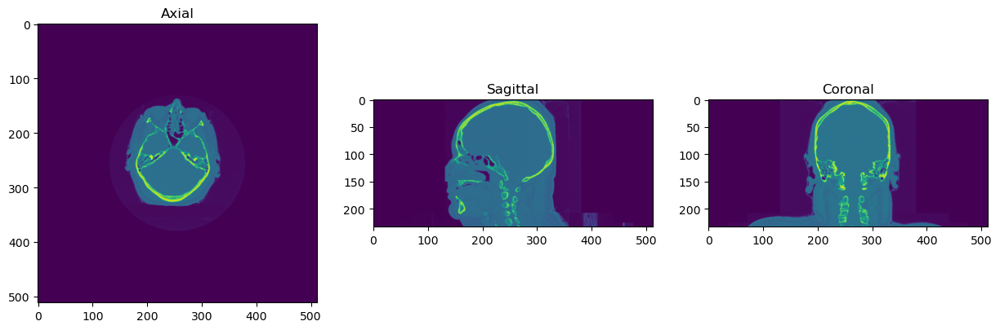

In [15]:
# Initialize an empty list to hold the DICOM files
files = []

# Load DICOM files into the list and print the count of loaded files
for index in range(1501, 1735):
    file_path = f"head/vhf.{index}.dcm"
    files.append(pydicom.dcmread(file_path))

print(f"File count: {len(files)}")

# Assume all slices have the same pixel spacing and slice thickness
ps = files[0].PixelSpacing
ss = float(files[0].SliceThickness)

# Print aspect ratios for verification
print(f"Pixel Spacing: {ps}")
print(f"Slice Thickness: {ss}")

# Create a 3D array to store the image data from the DICOM files
img_shape = list(files[0].pixel_array.shape)
img_shape.append(len(files))
img3d = np.zeros(img_shape)

# Fill the 3D array with image data from each DICOM file
for i, s in enumerate(files):
    img2d = s.pixel_array
    img3d[:, :, i] = img2d

# Call the function to visualize the slices
plot_slices(img3d)

### Loading, Processing, and Visualizing DICOM Image Data

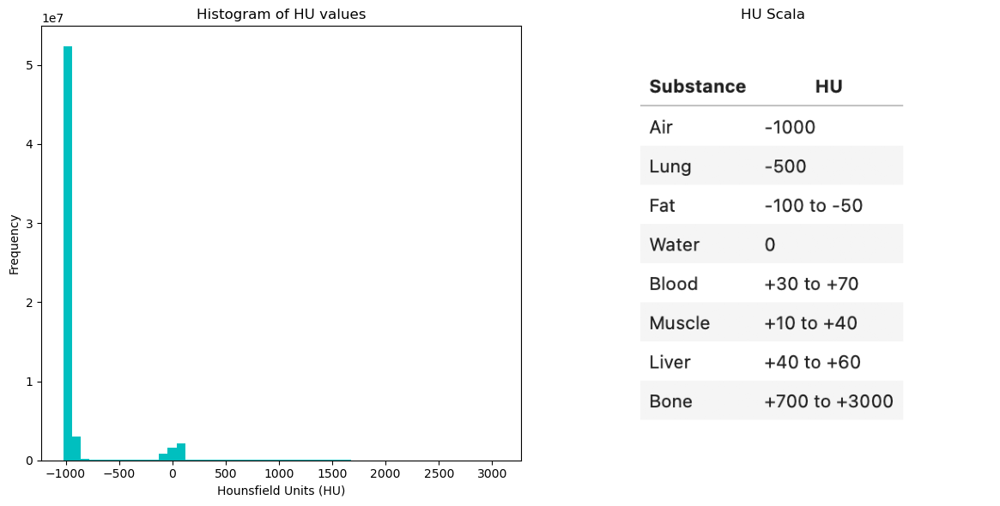

In [16]:
# Set an identifier for the patient data
id = 0

# Load DICOM images from the specified data path
patient = load_scan(data_path)

# Convert raw voxel values to Hounsfield units (HU)
imgs = get_pixels_hu(patient)

# Save the processed image data as a .npy file
np.save(output_path + f"fullimages_{id}.npy", imgs)

# Load the saved .npy file for further processing
file_used = output_path + f"fullimages_{id}.npy"
imgs_to_process = np.load(file_used).astype(np.float64)

# Path to the image file 
image_path = 'HU Scala.png'

# Load the image
image_data = mpimg.imread(image_path)

# Create a figure with 2 subplots
fig, ax = plt.subplots(1, 2, figsize=(12, 6))

# Plot histogram on the first subplot
ax[0].hist(imgs_to_process.flatten(), bins=50, color='c')
ax[0].set_xlabel("Hounsfield Units (HU)")
ax[0].set_ylabel("Frequency")
ax[0].set_title("Histogram of HU values")

# Plot image on the second subplot
ax[1].imshow(image_data)
ax[1].set_title("HU Scala")
ax[1].axis('off')  # Hide the axis

# Show the plot
plt.tight_layout()
plt.show()

# Critiquing the Histogram

### Our Histogram Suggests the Following:
- There is lots of air.
- There's also some fat (brain).
- There's an abundance of water.
- There is only a small bit of bone (seen as a tiny sliver of height between 1200-1700).

This observation means that we will need to do significant preprocessing if we want to process the 3D visualization of the skeleton because only a tiny bit of the voxels represent bone.

### Resampling:

Although we have each individual slices, it is not immediately clear how thick each slice is.
Fortunately, this is in the DICOM header.

In [17]:
print("Slice Thickness: %f" % patient[0].SliceThickness)
print("Pixel Spacing (row, col): (%f, %f) " % (patient[0].PixelSpacing[0], patient[0].PixelSpacing[1]))

Slice Thickness: 1.000000
Pixel Spacing (row, col): (1.000000, 1.000000) 


This means we have 1.0 mm slices, and each voxel represents 1.0 mm.

Because a CT slice is typically reconstructed at 512 x 512 voxels, each slice represents approximately 512 mm of data in length and width.

Using the metadata from the DICOM, we can figure out the size of each voxel as the slice thickness. In order to display the CT in 3D isometric form (which we will do below), and also to compare between different scans, it would be useful to ensure that each slice is resampled in 1x1x1 mm pixels and slices.


In [18]:
id = 0
imgs_to_process = np.load(output_path+'fullimages_{}.npy'.format(id))

# Load the scans and resample
scans = load_scan("head")
imgs = get_pixels_hu(scans)
imgs_after_resamp, spacing = resample(imgs, scans, [1,1,1])

# Check shape and spacing
print("Shape before resampling: ", imgs.shape)
print("Shape after resampling: ", imgs_after_resamp.shape)
print("Spacing: ", spacing)


Shape before resampling:  (234, 512, 512)
Shape after resampling:  (234, 512, 512)
Spacing:  [1. 1. 1.]


# 3D Plotting

## Overview

- Create interactive render using Plotly, which has WebGL support via JavaScript.
- The Marching Cubes algorithm is used to generate a 3D mesh from the dataset. The Plotly model will utilize a higher `step_size` with lower voxel threshold to avoid overwhelming the web browser.


It make take a while, please be patient.

Transposing surface
Calculating surface
Drawing


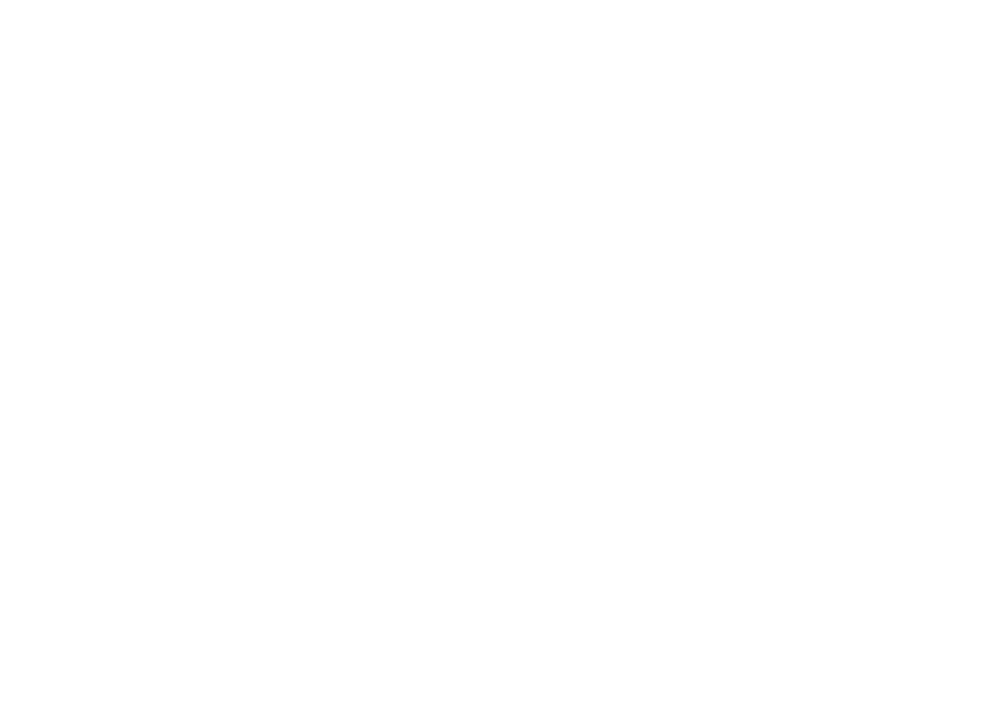

In [19]:
# Load the scans and resample the images
scans = load_scan("head")
imgs = get_pixels_hu(scans)
imgs_after_resamp, spacing = resample(imgs, scans, [1, 1, 1])

v, f = make_mesh(imgs_after_resamp, 350, 2)
plotly_3d(v, f)